In [1]:
from tqdm import tqdm
import os
import numpy as np
from datetime import datetime, timedelta
from sentinelhub import (
    SentinelHubRequest, SentinelHubCatalog, DataCollection, MimeType,
    CRS, BBox, bbox_to_dimensions, SHConfig
)
from dotenv import load_dotenv

load_dotenv()
config = SHConfig()
config.sh_client_id = os.getenv("CLIENT_ID")
config.sh_client_secret = os.getenv("CLIENT_SECRET")
assert config.sh_client_id and config.sh_client_secret, "Missing SentinelHub credentials"

# === (1) Cloud-aware Date Picker ===
def find_best_date(bbox_coords, start_date, end_date, max_cloud=20):
    catalog = SentinelHubCatalog(config)
    bbox = BBox(bbox=bbox_coords, crs=CRS.WGS84)

    search_iterator = catalog.search(
        collection=DataCollection.SENTINEL2_L2A,
        bbox=bbox,
        time=(start_date, end_date),
        filter=f"eo:cloud_cover < {max_cloud}",  # CQL2 filter
        fields={"include": ["properties.datetime", "properties.eo:cloud_cover"], "exclude": []}
    )

    results = sorted(search_iterator, key=lambda x: x["properties"]["eo:cloud_cover"])
    if not results:
        print(f"❌ No cloud-free image between {start_date} and {end_date}")
        return None

    best = results[0]
    best_date = best["properties"]["datetime"].split("T")[0]
    cloud = best["properties"]["eo:cloud_cover"]
    print(f"✅ Found image: {best_date} with cloud cover: {cloud:.2f}%")
    return best_date


# === (2) Download Patch ===
def download_patch(date_str, bbox_coords, save_dir):
    bbox = BBox(bbox=bbox_coords, crs=CRS.WGS84)
    size = bbox_to_dimensions(bbox, resolution=10)

    evalscript = """
    function setup() {
      return {
        input: [
          "B01", "B02", "B03", "B04", "B05", "B06",
          "B07", "B08", "B8A", "B09", "B11", "B12", "AOT"
        ],
        output: {
          bands: 13,
          sampleType: "FLOAT32"
        }
      };
    }
    function evaluatePixel(sample) {
      return [
        sample.B01, sample.B02, sample.B03, sample.B04, sample.B05,
        sample.B06, sample.B07, sample.B08, sample.B8A, sample.B09,
        sample.B11, sample.B12, sample.AOT
      ];
    }
    """

    request = SentinelHubRequest(
        data_folder=save_dir,
        evalscript=evalscript,
        input_data=[
            SentinelHubRequest.input_data(
                data_collection=DataCollection.SENTINEL2_L2A,
                time_interval=(date_str, date_str)
            )
        ],
        responses=[
            SentinelHubRequest.output_response("default", MimeType.TIFF)
        ],
        bbox=bbox,
        size=size,
        config=config
    )

    result = request.get_data(save_data=True)[0]
    npy_path = os.path.join(save_dir, f"{date_str}.npy")
    np.save(npy_path, result)
    print(f"💾 Saved {npy_path}")
    return npy_path

# === (3) Main Call ===
def get_images_cloud_filtered(bbox_coords, date_range_old, date_range_new, save_dir, max_cloud=20):
    os.makedirs(save_dir, exist_ok=True)

    print("🔍 Finding cloud-free old image...")
    old_date = find_best_date(bbox_coords, *date_range_old, max_cloud)
    if not old_date:
        return None, None

    print("📥 Downloading old image...")
    download_patch(old_date, bbox_coords, save_dir)

    print("🔍 Finding cloud-free new image...")
    new_date = find_best_date(bbox_coords, *date_range_new, max_cloud)
    if not new_date:
        return None, None

    print("📥 Downloading new image...")
    download_patch(new_date, bbox_coords, save_dir)

    return old_date, new_date


def viz_images(i1, i2, date_old, date_new):
    # Load the .npy files
    img1 = np.transpose(np.load(i1), (2, 0, 1))  # Shape: (13, H, W)
    img2 = np.transpose(np.load(i2), (2, 0, 1))  # Same

    print("Image 1 shape:", img1.shape)
    print("Image 2 shape:", img2.shape)
    
    print("Image 1 - NaNs:", np.isnan(img1).sum(), " Min:", np.nanmin(img1), " Max:", np.nanmax(img1))
    print("Image 2 - NaNs:", np.isnan(img2).sum(), " Min:", np.nanmin(img2), " Max:", np.nanmax(img2))
    
    # Replace NaNs with zeros
    img1 = np.nan_to_num(img1, nan=0.0)
    img2 = np.nan_to_num(img2, nan=0.0)
    
    # RGB: Red (B04), Green (B03), Blue (B02)
    rgb1 = np.stack([img1[3], img1[2], img1[1]], axis=-1)  # (H, W, 3)
    rgb2 = np.stack([img2[3], img2[2], img2[1]], axis=-1)

    # Normalize for display
    rgb1 = rgb1 / np.percentile(rgb1, 99)
    rgb2 = rgb2 / np.percentile(rgb2, 99)
    
    rgb1 = np.clip(rgb1, 0, 1)
    rgb2 = np.clip(rgb2, 0, 1)

    # Plot
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title(date_old + " (Old)")
    plt.imshow(rgb1)
    plt.axis("off")
    
    plt.subplot(1, 2, 2)
    plt.title(date_new + " (New)")
    plt.imshow(rgb2)
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()

import numpy as np
import matplotlib.pyplot as plt

def viz_images_full(i1, i2, date_old, date_new):
    # Load and transpose images to shape (13, H, W)
    img1 = np.transpose(np.load(i1), (2, 0, 1))
    img2 = np.transpose(np.load(i2), (2, 0, 1))

    print("Image 1 shape:", img1.shape)
    print("Image 2 shape:", img2.shape)
    print("Image 1 - NaNs:", np.isnan(img1).sum(), "Min:", np.nanmin(img1), "Max:", np.nanmax(img1))
    print("Image 2 - NaNs:", np.isnan(img2).sum(), "Min:", np.nanmin(img2), "Max:", np.nanmax(img2))

    # Replace NaNs for visualization
    img1 = np.nan_to_num(img1, nan=0.0)
    img2 = np.nan_to_num(img2, nan=0.0)

    # Construct RGB: B04 (Red), B03 (Green), B02 (Blue)
    rgb1 = np.stack([img1[3], img1[2], img1[1]], axis=-1)
    rgb2 = np.stack([img2[3], img2[2], img2[1]], axis=-1)

    # Normalize RGB
    rgb1 = rgb1 / np.percentile(rgb1, 99)
    rgb2 = rgb2 / np.percentile(rgb2, 99)

    # Compute NDVI = (NIR - Red) / (NIR + Red)
    def compute_ndvi(img):
        nir = img[7]  # B08
        red = img[3]  # B04
        ndvi = (nir - red) / (nir + red + 1e-6)
        return np.clip(ndvi, -1, 1)

    ndvi1 = compute_ndvi(img1)
    ndvi2 = compute_ndvi(img2)

    # Spectral difference: Euclidean distance across all 13 bands
    diff = np.linalg.norm(img2 - img1, axis=0)

    # Plotting
    plt.figure(figsize=(14, 10))

    plt.subplot(2, 2, 1)
    plt.title(f"RGB: {date_old}")
    plt.imshow(rgb1)
    plt.axis("off")

    plt.subplot(2, 2, 2)
    plt.title(f"RGB: {date_new}")
    plt.imshow(rgb2)
    plt.axis("off")

    plt.subplot(2, 2, 3)
    plt.title(f"NDVI Difference ({date_old} → {date_new})")
    plt.imshow(ndvi2 - ndvi1, cmap='RdYlGn', vmin=-1, vmax=1)
    plt.colorbar(label='NDVI Δ')
    plt.axis("off")

    plt.subplot(2, 2, 4)
    plt.title("Spectral Difference (L2 norm across 13 bands)")
    plt.imshow(diff, cmap='inferno')
    plt.colorbar(label='Spectral Δ')
    plt.axis("off")

    plt.tight_layout()
    plt.show()


In [2]:
import numpy as np
from PIL import Image

def compute_ndvi(image):
    """
    Compute NDVI from a 13-band Sentinel-2 image
    Args:
        image: np.ndarray of shape (13, H, W)
    Returns:
        NDVI: np.ndarray of shape (H, W)
    """
    nir = image[7].astype(np.float32)  # Band 8: NIR
    red = image[3].astype(np.float32)  # Band 4: Red
    ndvi = (nir - red) / (nir + red + 1e-6)
    return np.clip(ndvi, -1, 1)  # Clip for stability

def create_change_map(i1, i2, threshold=0.1):
    """
    Create a binary change map based on NDVI difference
    Args:
        img_old, img_new: np.ndarray of shape (13, H, W)
        threshold: float — NDVI change threshold
    Returns:
        change_map: np.ndarray of shape (H, W), dtype=np.uint8 (0 or 1)
    """
    # Load and transpose images to shape (13, H, W)
    img_old = np.transpose(np.load(i1), (2, 0, 1))
    img_new = np.transpose(np.load(i2), (2, 0, 1))
    ndvi_old = compute_ndvi(img_old)
    ndvi_new = compute_ndvi(img_new)
    diff = np.abs(ndvi_new - ndvi_old)
    change_map = (diff > threshold).astype(np.uint8)
    return change_map

def save_change_map_png(cm, save_path):
    """
    Save a binary change map as a .png image (0 or 255)
    """
    assert cm.dtype == np.uint8 and cm.ndim == 2, "Expected 2D uint8 mask"
    img = Image.fromarray(cm * 255)  # Convert 0/1 to 0/255
    img.save(save_path)

import os
import numpy as np
import rasterio
import shutil

import hashlib
import glob

def find_response_tiff_for_npy(src_dir, npy_filename):
    """
    Finds the path to the response.tiff most closely associated with the given .npy file,
    based on nearest modification time.
    """
    npy_path = os.path.join(src_dir, npy_filename)
    if not os.path.exists(npy_path):
        raise FileNotFoundError(f"Numpy file not found: {npy_path}")
    
    npy_time = os.path.getmtime(npy_path)
    
    # Search all response.tiff files inside subdirectories
    candidate_paths = glob.glob(os.path.join(src_dir, "*", "response.tiff"))
    if not candidate_paths:
        raise FileNotFoundError("No response.tiff files found in subdirectories.")

    closest_path = None
    min_time_diff = float("inf")

    for path in candidate_paths:
        tiff_time = os.path.getmtime(path)
        time_diff = abs(tiff_time - npy_time)
        if time_diff < min_time_diff:
            min_time_diff = time_diff
            closest_path = path

    if closest_path is None:
        raise RuntimeError("Could not find a suitable response.tiff.")

    return closest_path

def convert_oscd(src_dir, dst_dir, img_1, img_2, date1="20200501", date2="20200915"):
    os.makedirs(dst_dir, exist_ok=True)

    imgs1_dir = os.path.join(dst_dir, "imgs_1")
    imgs2_dir = os.path.join(dst_dir, "imgs_2")
    cm_dir = os.path.join(dst_dir, "cm")
    for d in [imgs1_dir, imgs2_dir, cm_dir]:
        os.makedirs(d, exist_ok=True)

    band_map = {
        0: "B01", 1: "B02", 2: "B03", 3: "B04", 4: "B05",
        5: "B06", 6: "B07", 7: "B08", 8: "B09", 9: "B10",
        10: "B11", 11: "B12", 12: "B8A"
    }

    # Load npy image data
    img1_path = os.path.join(src_dir, img_1)
    img2_path = os.path.join(src_dir, img_2)
    img1 = np.load(img1_path)  # (H, W, 13)
    img2 = np.load(img2_path)

    # Get response.tiff for img_1
    ref_path = find_response_tiff_for_npy(src_dir, img_1)
    with rasterio.open(ref_path) as src:
        profile = src.profile
        transform = src.transform
        crs = src.crs

    profile.update({
        "count": 1,
        "dtype": "uint16",
        "compress": "deflate",
        "height": img1.shape[0],
        "width": img1.shape[1],
        "transform": transform,
        "crs": crs
    })

    # Save each band
    for i in range(13):
        band_name = band_map[i]
        out1 = os.path.join(imgs1_dir, f"TEMP_{date1}_{band_name}.tif")
        out2 = os.path.join(imgs2_dir, f"TEMP_{date2}_{band_name}.tif")

        with rasterio.open(out1, "w", **profile) as dst:
            # Scale from [0,1] to Sentinel-2 style [0, 10000], clip to uint16 range
            dst.write((img1[:, :, i] * 10000).clip(0, 65535).astype(np.uint16), 1)

        with rasterio.open(out2, "w", **profile) as dst:
            dst.write((img2[:, :, i] * 10000).clip(0, 65535).astype(np.uint16), 1)

    # Copy change map
    shutil.copy(os.path.join(src_dir, "change_map.png"), os.path.join(cm_dir, "cm.png"))

    print("✅ Converted patch to OSCD-style dataset under:", dst_dir)

import os
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import reshape_as_image
from PIL import Image

def load_rgb_from_oscd(img_dir, prefix):
    # Identify paths for B04 (Red), B03 (Green), B02 (Blue)
    red_path = os.path.join(img_dir, f"{prefix}_B04.tif")
    green_path = os.path.join(img_dir, f"{prefix}_B03.tif")
    blue_path = os.path.join(img_dir, f"{prefix}_B02.tif")

    # Read each band using rasterio
    with rasterio.open(red_path) as r:
        red = r.read(1).astype(np.float32)
    with rasterio.open(green_path) as g:
        green = g.read(1).astype(np.float32)
    with rasterio.open(blue_path) as b:
        blue = b.read(1).astype(np.float32)

    # Stack into RGB
    rgb = np.stack([red, green, blue], axis=-1)

    # Normalize to [0, 1] for visualization
    rgb = rgb / np.percentile(rgb, 99)
    rgb = np.clip(rgb, 0, 1)

    return rgb

def visualize_oscd_patch(oscd_dir):
    imgs_1_dir = os.path.join(oscd_dir, "imgs_1")
    imgs_2_dir = os.path.join(oscd_dir, "imgs_2")
    cm_path = os.path.join(oscd_dir, "cm", "cm.png")

    # Get a common prefix for file names
    file_names1 = os.listdir(imgs_1_dir)
    prefix1 = "_".join(file_names1[0].split("_")[:2])  # e.g., TEMP_20200501

    file_names2 = os.listdir(imgs_2_dir)
    prefix2 = "_".join(file_names2[0].split("_")[:2])  # e.g., TEMP_20200501

    # Load RGB composites
    rgb1 = load_rgb_from_oscd(imgs_1_dir, prefix1)
    #print("RGB band min/max:", rgb1.min(), rgb1.max(), " | 99th percentile:", np.percentile(rgb1, 99))
    #rgb2 = load_rgb_from_oscd(imgs_2_dir, prefix.replace("2020", "2021") if "2020" in prefix else "TEMP_20200915")
    rgb2 = load_rgb_from_oscd(imgs_2_dir, prefix2)
    #print("RGB band min/max:", rgb2.min(), rgb2.max(), " | 99th percentile:", np.percentile(rgb2, 99))

    # Load change map
    cm = np.array(Image.open(cm_path))

    # Display
    fig, axes = plt.subplots(1, 3, figsize=(16, 6))
    axes[0].imshow(rgb1)
    axes[0].set_title("Image at t0")
    axes[0].axis("off")

    axes[1].imshow(rgb2)
    axes[1].set_title("Image at t1")
    axes[1].axis("off")

    axes[2].imshow(cm, cmap="gray")
    axes[2].set_title("Change Map")
    axes[2].axis("off")

    plt.tight_layout()
    plt.show()

In [3]:
def create_oscd_entry(old_date, new_date, loc_path):
    i1="data/patches/"+loc_path+old_date+".npy"
    i2="data/patches/"+loc_path+new_date+".npy"
    
    src_dir = "data/patches/"+loc_path
    dst_dir = "OSCD/crop_rotation/"+loc_path
    
    cm_path =  "./data/patches/"+loc_path+"change_map.png"
    
    # Load .npy images
    img_1 = old_date+".npy"
    img_2 = new_date+".npy"
    
    cm = create_change_map(i1, i2)
    save_change_map_png(cm, cm_path)
    convert_oscd(src_dir, dst_dir, img_1, img_2,date1=old_date, date2=new_date)
    visualize_oscd_patch(dst_dir)

In [6]:
bbox_iowa = (-93.7, 41.9, -93.6, 42.0)
save_dir = "data/patches/crop_rotation_iowa_2020"

date_range_old = ("2020-04-01", "2020-06-01")
date_range_new = ("2020-08-15", "2020-10-15")

old_date, new_date = get_images_cloud_filtered(bbox_iowa, date_range_old, date_range_new, save_dir)

🔍 Finding cloud-free old image...
✅ Found image: 2020-04-21 with cloud cover: 0.00%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_iowa_2020/2020-04-21.npy
🔍 Finding cloud-free new image...
✅ Found image: 2020-10-08 with cloud cover: 0.00%
📥 Downloading new image...
💾 Saved data/patches/crop_rotation_iowa_2020/2020-10-08.npy


Image 1 shape: (13, 1104, 837)
Image 2 shape: (13, 1104, 837)
Image 1 - NaNs: 0  Min: 0.0  Max: 1.1152
Image 2 - NaNs: 0  Min: 0.0  Max: 0.819


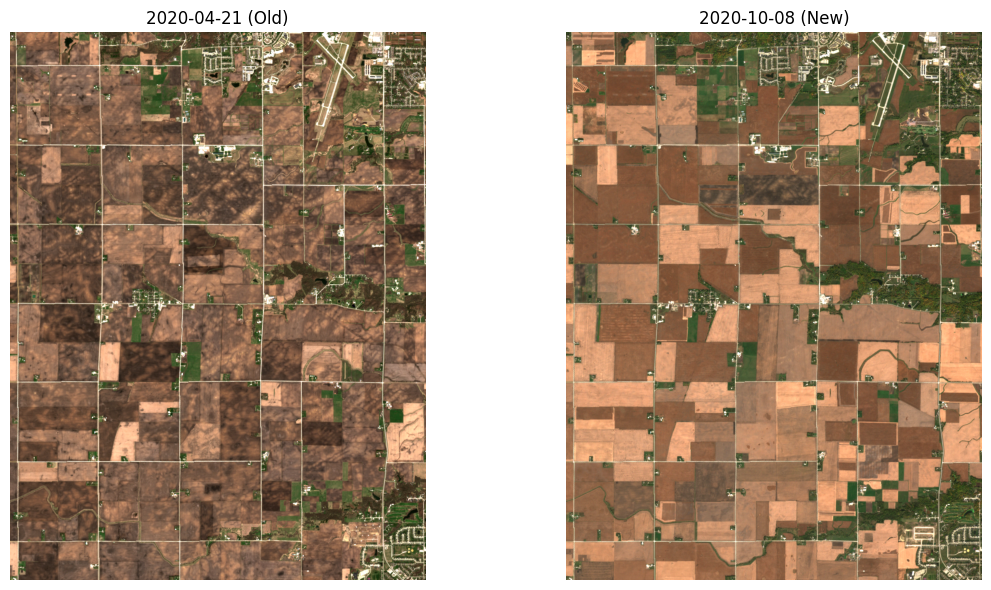

In [8]:
i1="data/patches/crop_rotation_iowa_2020/"+old_date+".npy"
i2="data/patches/crop_rotation_iowa_2020/"+new_date+".npy"

viz_images(i1, i2, old_date, new_date)

Image 1 shape: (13, 1104, 837)
Image 2 shape: (13, 1104, 837)
Image 1 - NaNs: 0 Min: 0.0 Max: 1.1152
Image 2 - NaNs: 0 Min: 0.0 Max: 0.819


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00044247787..4.9345136].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00779896..3.4991336].


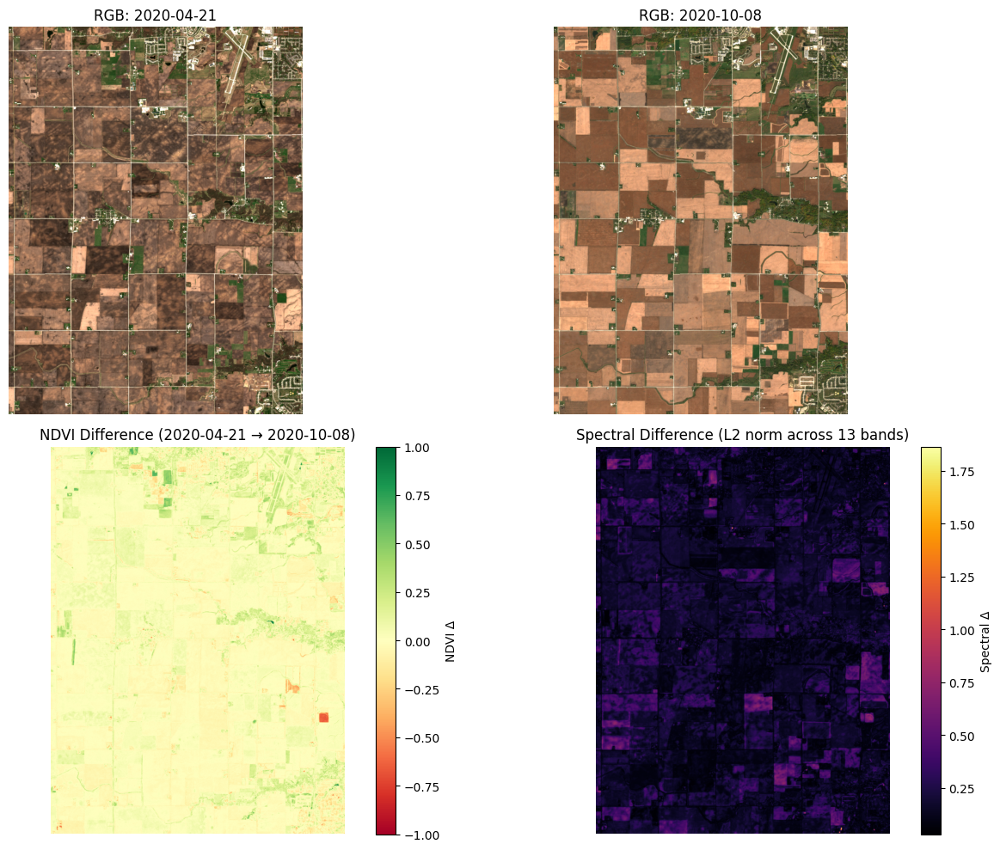

In [10]:
viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2021-05-26 with cloud cover: 0.00%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_iowa_2021/2021-05-26.npy
🔍 Finding cloud-free new image...
✅ Found image: 2021-09-23 with cloud cover: 0.00%
📥 Downloading new image...
💾 Saved data/patches/crop_rotation_iowa_2021/2021-09-23.npy
Image 1 shape: (13, 1104, 837)
Image 2 shape: (13, 1104, 837)
Image 1 - NaNs: 0  Min: 1e-04  Max: 1.2312
Image 2 - NaNs: 0  Min: 0.0  Max: 0.8288


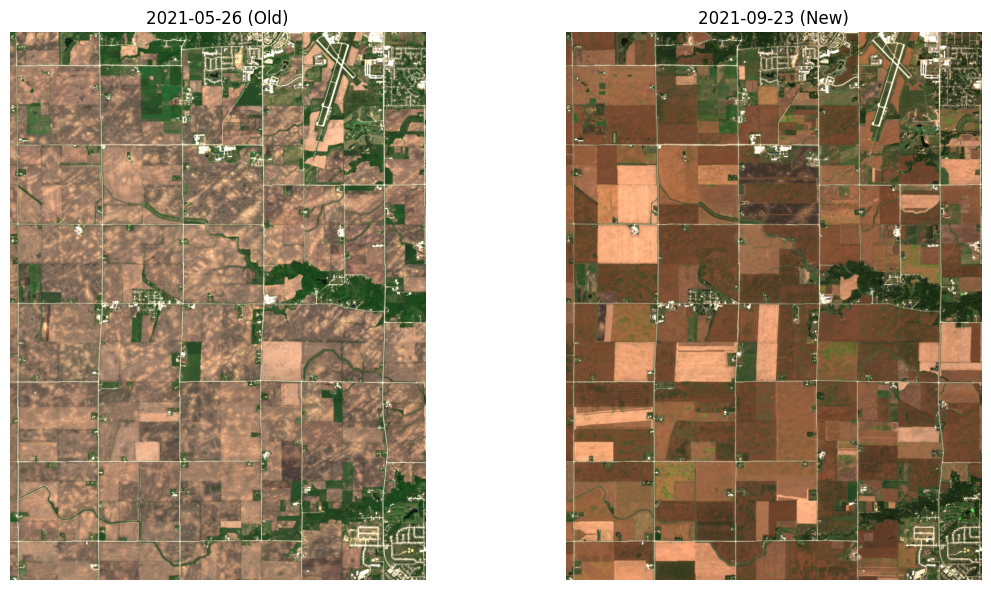

In [17]:
bbox_iowa = (-93.7, 41.9, -93.6, 42.0)
save_dir = "data/patches/crop_rotation_iowa_2021"

date_range_old = ("2021-04-01", "2021-06-01")
date_range_new = ("2021-08-15", "2021-10-15")

old_date, new_date = get_images_cloud_filtered(bbox_iowa, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_iowa_2021/"+old_date+".npy"
i2="data/patches/crop_rotation_iowa_2021/"+new_date+".npy"

viz_images(i1, i2, old_date, new_date)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0004975124..6.125373].


Image 1 shape: (13, 1104, 837)
Image 2 shape: (13, 1104, 837)
Image 1 - NaNs: 0 Min: 1e-04 Max: 1.2312
Image 2 - NaNs: 0 Min: 0.0 Max: 0.8288


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00046468398..3.8513012].


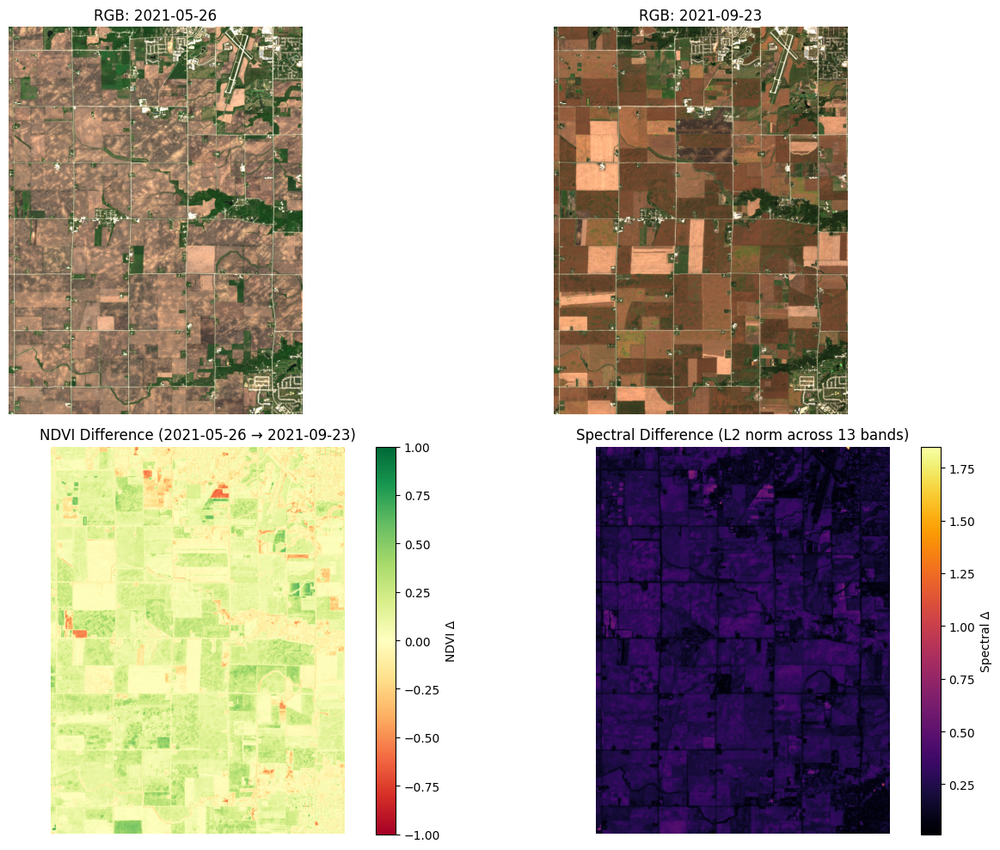

In [18]:
viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2022-04-26 with cloud cover: 0.30%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_iowa_2022/2022-04-26.npy
🔍 Finding cloud-free new image...
✅ Found image: 2022-09-28 with cloud cover: 0.00%
📥 Downloading new image...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.689276].


💾 Saved data/patches/crop_rotation_iowa_2022/2022-09-28.npy
Image 1 shape: (13, 1104, 837)
Image 2 shape: (13, 1104, 837)
Image 1 - NaNs: 0 Min: 0.0 Max: 1.032
Image 2 - NaNs: 0 Min: 0.0 Max: 0.84


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.506438].


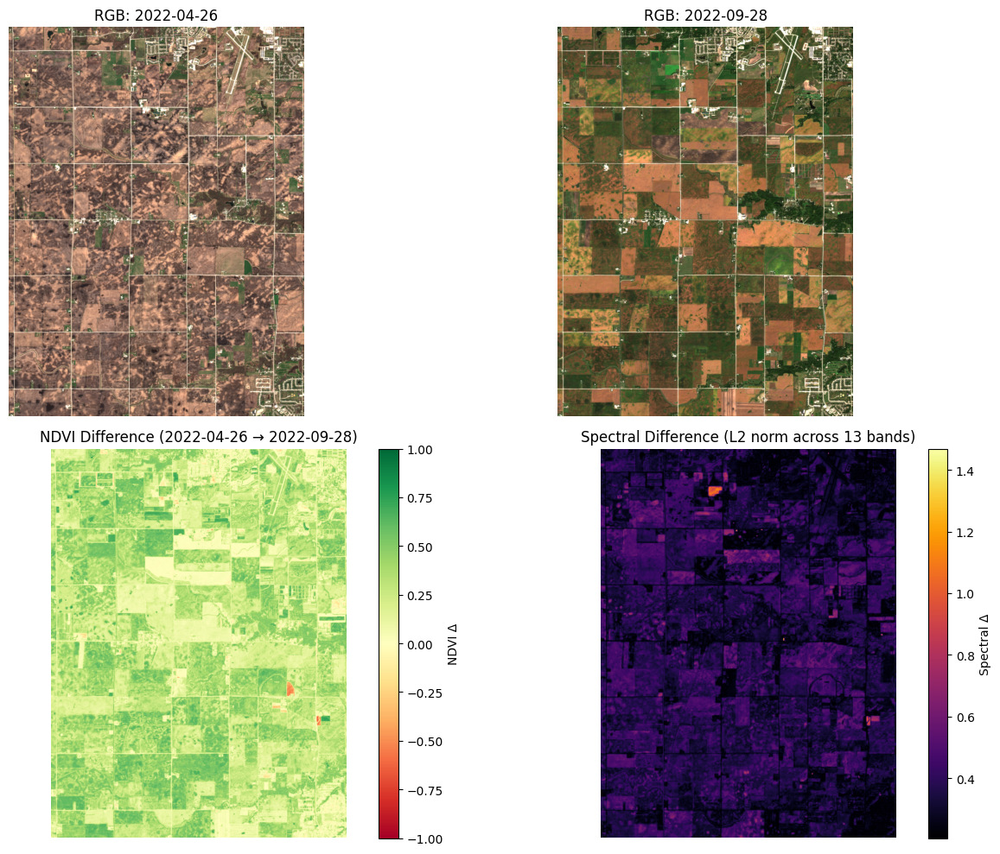

In [22]:
bbox_iowa = (-93.7, 41.9, -93.6, 42.0)
save_dir = "data/patches/crop_rotation_iowa_2022"

date_range_old = ("2022-04-01", "2022-06-01")
date_range_new = ("2022-08-15", "2022-10-15")

old_date, new_date = get_images_cloud_filtered(bbox_iowa, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_iowa_2022/"+old_date+".npy"
i2="data/patches/crop_rotation_iowa_2022/"+new_date+".npy"

viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2017-05-07 with cloud cover: 0.12%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_iowa_2017/2017-05-07.npy
🔍 Finding cloud-free new image...
✅ Found image: 2017-08-23 with cloud cover: 0.04%
📥 Downloading new image...
💾 Saved data/patches/crop_rotation_iowa_2017/2017-08-23.npy
Image 1 shape: (13, 1104, 837)
Image 2 shape: (13, 1104, 837)
Image 1 - NaNs: 0 Min: 0.0021 Max: 1.3272
Image 2 - NaNs: 0 Min: 1e-04 Max: 1.2888


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.06949807..6.4054055].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0004570384..5.890311].


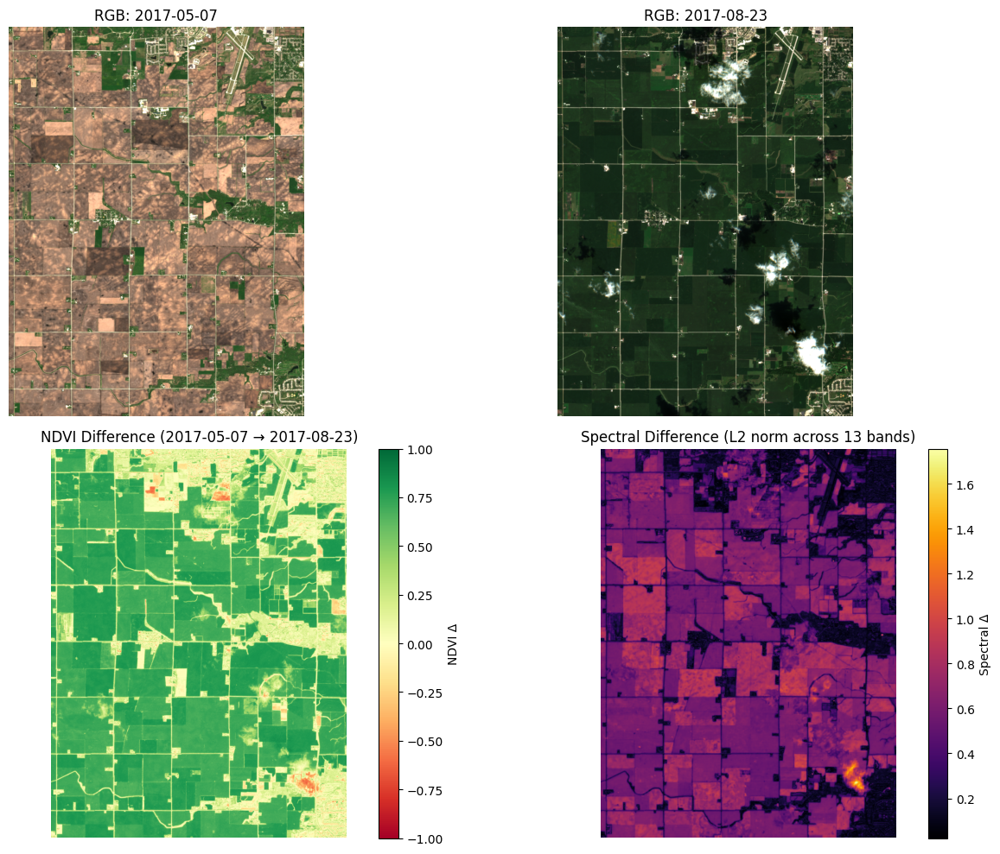

In [21]:
bbox_iowa = (-93.7, 41.9, -93.6, 42.0)
save_dir = "data/patches/crop_rotation_iowa_2017"

date_range_old = ("2017-04-01", "2017-06-01")
date_range_new = ("2017-08-15", "2017-10-15")

old_date, new_date = get_images_cloud_filtered(bbox_iowa, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_iowa_2017/"+old_date+".npy"
i2="data/patches/crop_rotation_iowa_2017/"+new_date+".npy"

viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2020-05-15 with cloud cover: 0.11%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_ukr_kharkivoblast_2020/2020-05-15.npy
🔍 Finding cloud-free new image...
✅ Found image: 2020-09-19 with cloud cover: 0.00%
📥 Downloading new image...
💾 Saved data/patches/crop_rotation_ukr_kharkivoblast_2020/2020-09-19.npy
Image 1 shape: (13, 1100, 910)
Image 2 shape: (13, 1100, 910)
Image 1 - NaNs: 0 Min: 1e-04 Max: 1.7216
Image 2 - NaNs: 0 Min: 0.0241 Max: 1.0834


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00018839487..3.2434063].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08409987..3.2720106].


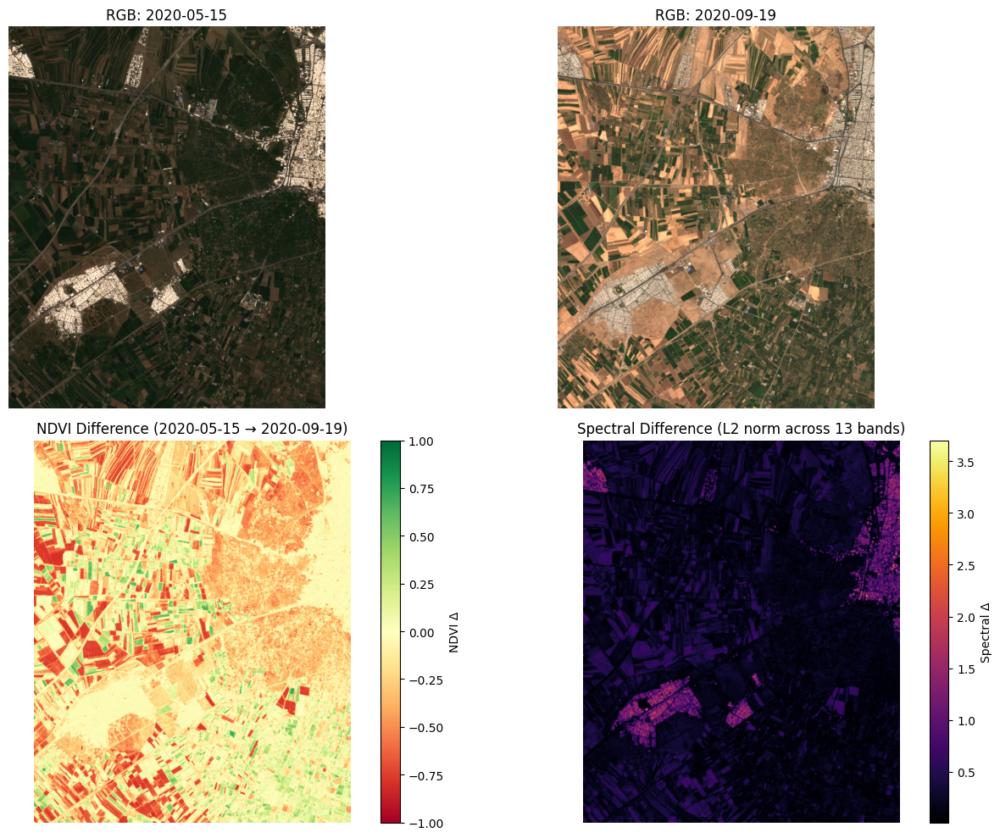

In [9]:
bbox = (49.9, 36.2, 50.0, 36.3)
#bbox = (48.9, 31.4, 49.0, 31.5)
#bbox = (49.6, 34.5, 49.7, 34.6)
save_dir = "data/patches/crop_rotation_ukr_kharkivoblast_2020"

date_range_old = ("2020-04-01", "2020-06-01")
date_range_new = ("2020-08-15", "2020-10-15")
old_date, new_date = get_images_cloud_filtered(bbox, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_ukr_kharkivoblast_2020/"+old_date+".npy"
i2="data/patches/crop_rotation_ukr_kharkivoblast_2020/"+new_date+".npy"

viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2021-05-30 with cloud cover: 0.00%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_ukr_kharkivoblast_2021/2021-05-30.npy
🔍 Finding cloud-free new image...
✅ Found image: 2021-10-14 with cloud cover: 0.00%
📥 Downloading new image...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0001749475..2.9839048].


💾 Saved data/patches/crop_rotation_ukr_kharkivoblast_2021/2021-10-14.npy
Image 1 shape: (13, 1100, 910)
Image 2 shape: (13, 1100, 910)
Image 1 - NaNs: 0 Min: 1e-04 Max: 1.7056
Image 2 - NaNs: 0 Min: 0.0193 Max: 1.6432


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.07713391..6.4338293].


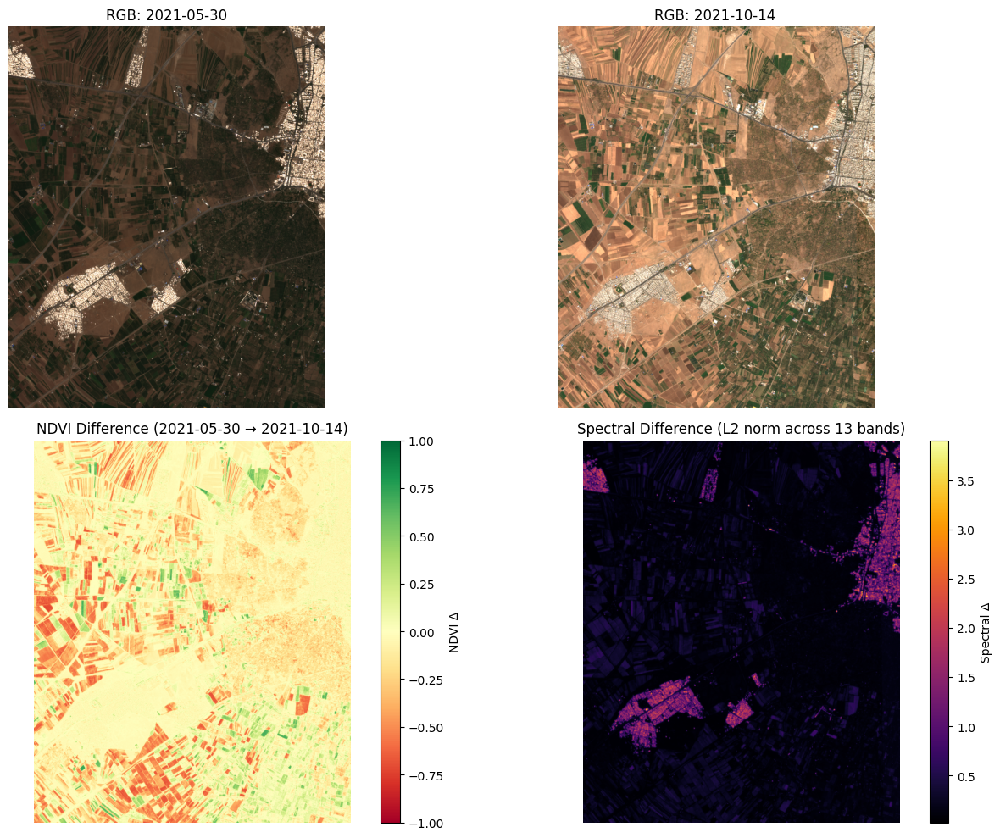

In [10]:
bbox = (49.9, 36.2, 50.0, 36.3)
#bbox = (48.9, 31.4, 49.0, 31.5)
#bbox = (49.6, 34.5, 49.7, 34.6)
save_dir = "data/patches/crop_rotation_ukr_kharkivoblast_2021"

date_range_old = ("2021-04-01", "2021-06-01")
date_range_new = ("2021-08-15", "2021-10-15")
old_date, new_date = get_images_cloud_filtered(bbox, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_ukr_kharkivoblast_2021/"+old_date+".npy"
i2="data/patches/crop_rotation_ukr_kharkivoblast_2021/"+new_date+".npy"

viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2020-05-27 with cloud cover: 0.00%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_ukr_cherkasyoblast_2020/2020-05-27.npy
🔍 Finding cloud-free new image...
✅ Found image: 2020-10-12 with cloud cover: 0.00%
📥 Downloading new image...
💾 Saved data/patches/crop_rotation_ukr_cherkasyoblast_2020/2020-10-12.npy
Image 1 shape: (13, 1091, 971)
Image 2 shape: (13, 1091, 971)
Image 1 - NaNs: 0 Min: 0.0656 Max: 1.1905
Image 2 - NaNs: 0 Min: 0.0 Max: 0.608


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.18252642..1.4858096].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0021598272..1.5475161].


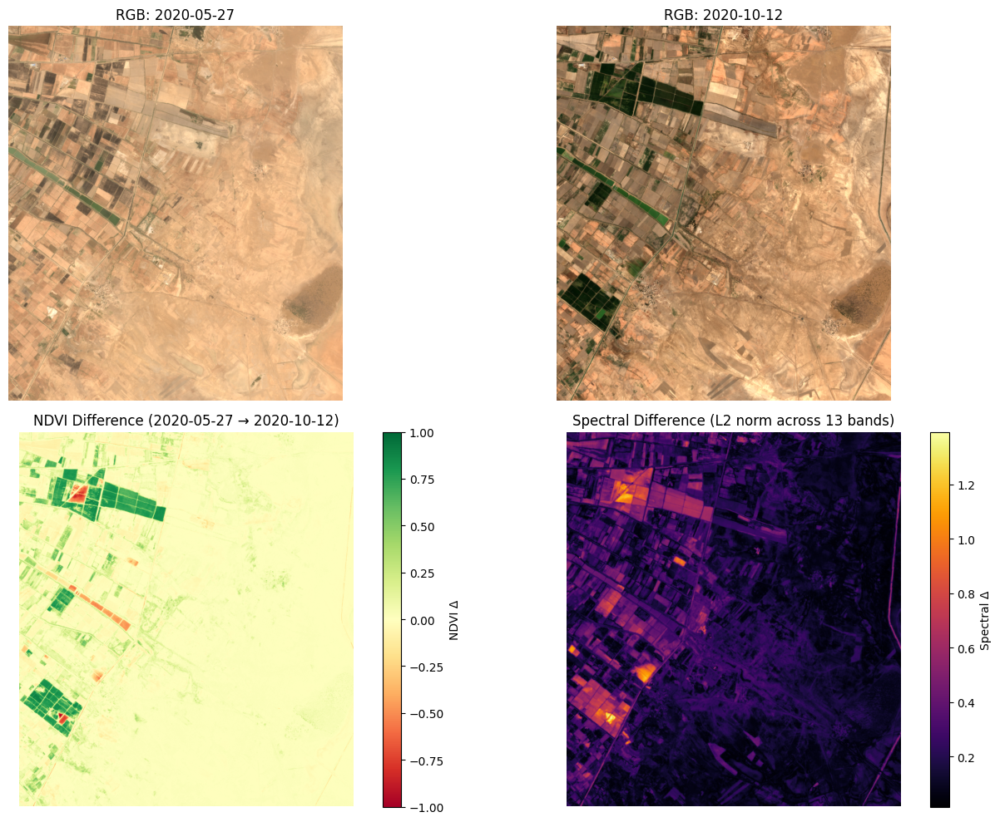

In [11]:
bbox = (48.9, 31.4, 49.0, 31.5)
#bbox = (49.6, 34.5, 49.7, 34.6)
save_dir = "data/patches/crop_rotation_ukr_cherkasyoblast_2020"

date_range_old = ("2020-04-01", "2020-06-01")
date_range_new = ("2020-08-15", "2020-10-15")
old_date, new_date = get_images_cloud_filtered(bbox, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_ukr_cherkasyoblast_2020/"+old_date+".npy"
i2="data/patches/crop_rotation_ukr_cherkasyoblast_2020/"+new_date+".npy"

viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2021-06-01 with cloud cover: 0.00%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_ukr_cherkasyoblast_2021/2021-06-01.npy
🔍 Finding cloud-free new image...
✅ Found image: 2021-10-14 with cloud cover: 0.00%
📥 Downloading new image...
💾 Saved data/patches/crop_rotation_ukr_cherkasyoblast_2021/2021-10-14.npy
Image 1 shape: (13, 1091, 971)
Image 2 shape: (13, 1091, 971)
Image 1 - NaNs: 0 Min: 0.0 Max: 0.6496
Image 2 - NaNs: 0 Min: 0.0277 Max: 0.5832


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.031131178..1.5437263].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.09316604..1.3806727].


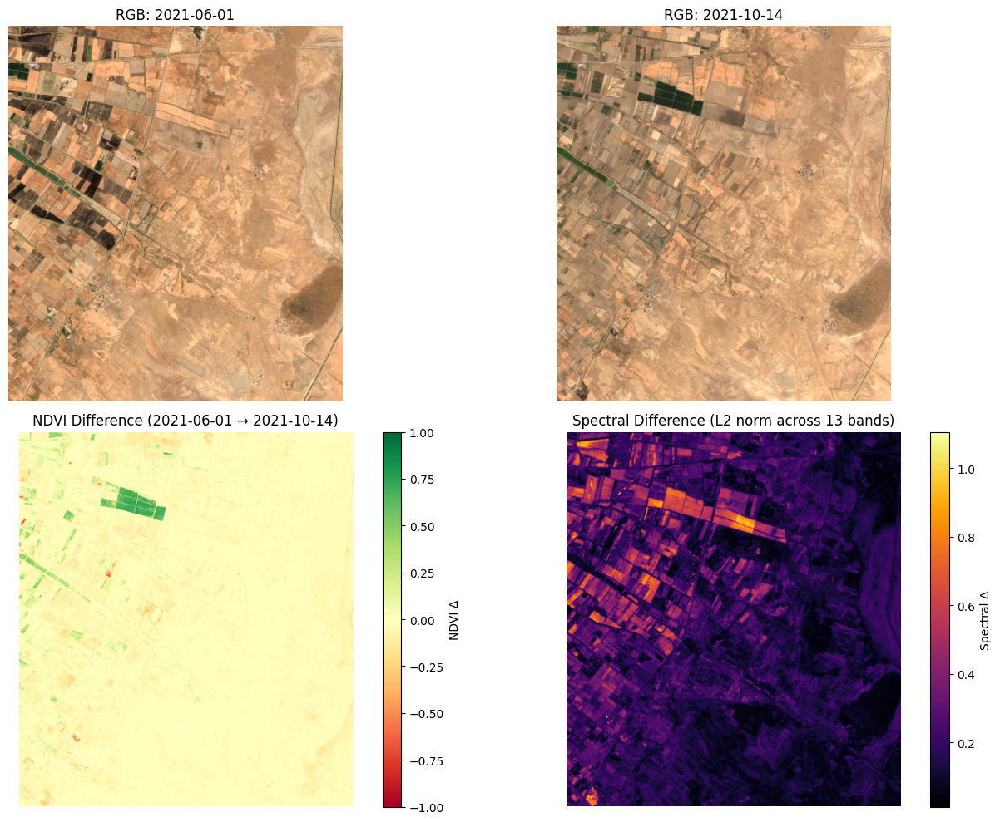

In [12]:
bbox = (48.9, 31.4, 49.0, 31.5)
#bbox = (49.6, 34.5, 49.7, 34.6)
save_dir = "data/patches/crop_rotation_ukr_cherkasyoblast_2021"

date_range_old = ("2021-04-01", "2021-06-01")
date_range_new = ("2021-08-15", "2021-10-15")
old_date, new_date = get_images_cloud_filtered(bbox, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_ukr_cherkasyoblast_2021/"+old_date+".npy"
i2="data/patches/crop_rotation_ukr_cherkasyoblast_2021/"+new_date+".npy"

viz_images_full(i1, i2, old_date, new_date)

🔍 Finding cloud-free old image...
✅ Found image: 2019-04-13 with cloud cover: 0.00%
📥 Downloading old image...
💾 Saved data/patches/crop_rotation_occitanie_2019/2019-04-13.npy
🔍 Finding cloud-free new image...
✅ Found image: 2019-09-25 with cloud cover: 2.18%
📥 Downloading new image...
💾 Saved data/patches/crop_rotation_occitanie_2019/2019-09-25.npy
Image 1 shape: (13, 1105, 1113)
Image 2 shape: (13, 1105, 1113)
Image 1 - NaNs: 0 Min: 0.0007 Max: 0.779
Image 2 - NaNs: 0 Min: 0.0022 Max: 0.7944


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0049226442..2.891702].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.034050178..2.4456391].


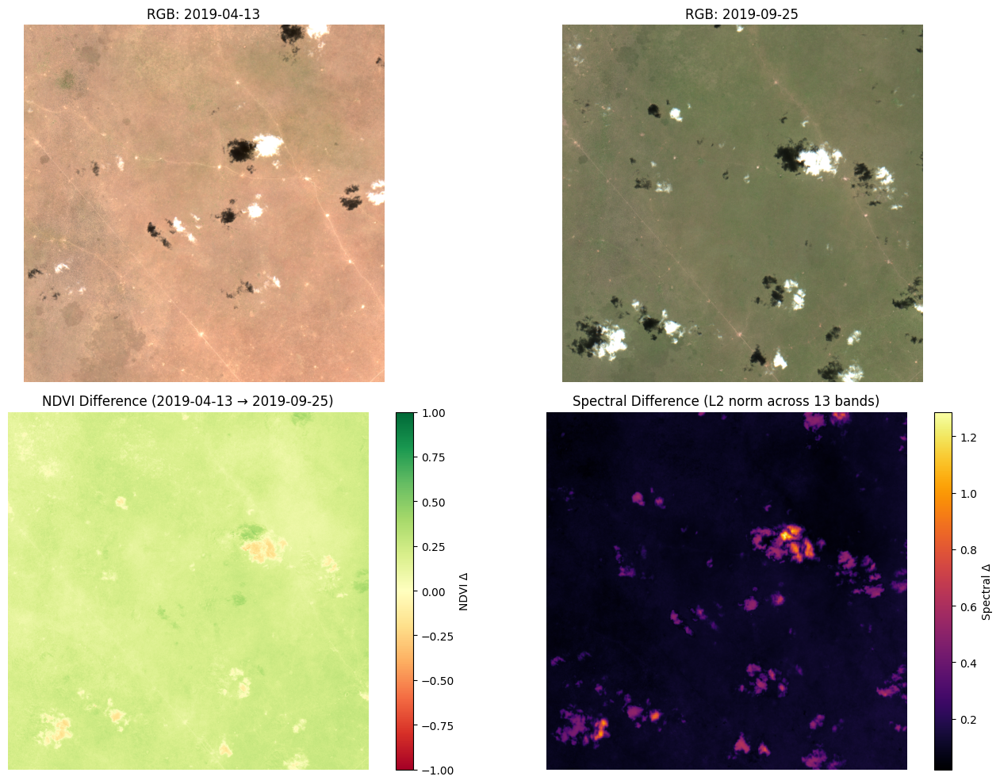

In [51]:
bbox = (43.6117, 1.4526, 43.7117, 1.5526)  
save_dir = "data/patches/crop_rotation_occitanie_2019"

date_range_old = ("2019-04-01", "2019-06-01")
date_range_new = ("2019-08-15", "2019-10-15")
old_date, new_date = get_images_cloud_filtered(bbox, date_range_old, date_range_new, save_dir)
i1="data/patches/crop_rotation_occitanie_2019/"+old_date+".npy"
i2="data/patches/crop_rotation_occitanie_2019/"+new_date+".npy"

viz_images_full(i1, i2, old_date, new_date)

In [88]:
# Source and destination directories

old_date = "2020-04-21"
new_date = "2020-10-08"

loc_path = "crop_rotation_iowa_2020/"

i1="data/patches/"+loc_path+old_date+".npy"
i2="data/patches/"+loc_path+new_date+".npy"

src_dir = "data/patches/"+loc_path
dst_dir = "OSCD/crop_rotation/"+loc_path

cm_path =  "./data/patches/"+loc_path+"change_map.png"

# Load .npy images
img_1 = old_date+".npy"
img_2 = new_date+".npy"

cm = create_change_map(i1, i2)
save_change_map_png(cm, cm_path)
convert_oscd(src_dir, dst_dir, img_1, img_2,date1=old_date, date2=new_date)

✅ Converted patch to OSCD-style dataset under: OSCD/crop_rotation/crop_rotation_iowa_2020/


✅ Converted patch to OSCD-style dataset under: OSCD/crop_rotation/crop_rotation_iowa_2021/


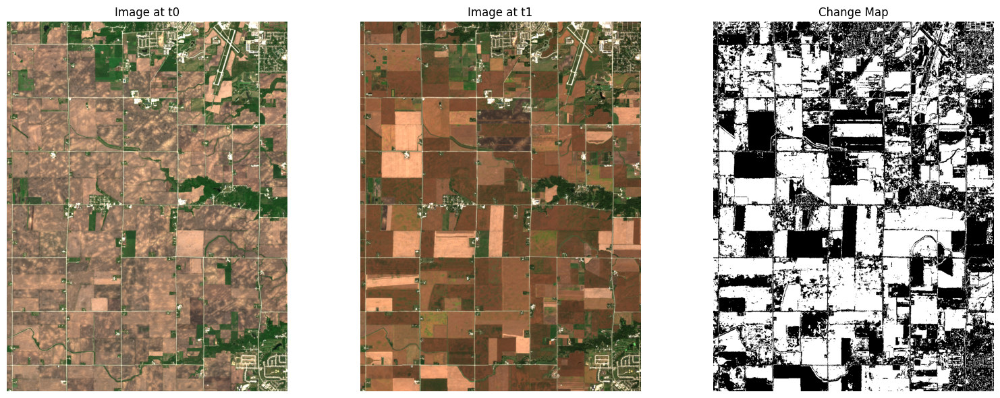

In [7]:
# crop_rotation_iowa_2021
old_date = "2021-05-26"
new_date = "2021-09-23"
loc_path = "crop_rotation_iowa_2021/"
create_oscd_entry(old_date, new_date, loc_path)

✅ Converted patch to OSCD-style dataset under: OSCD/crop_rotation/crop_rotation_iowa_2019/


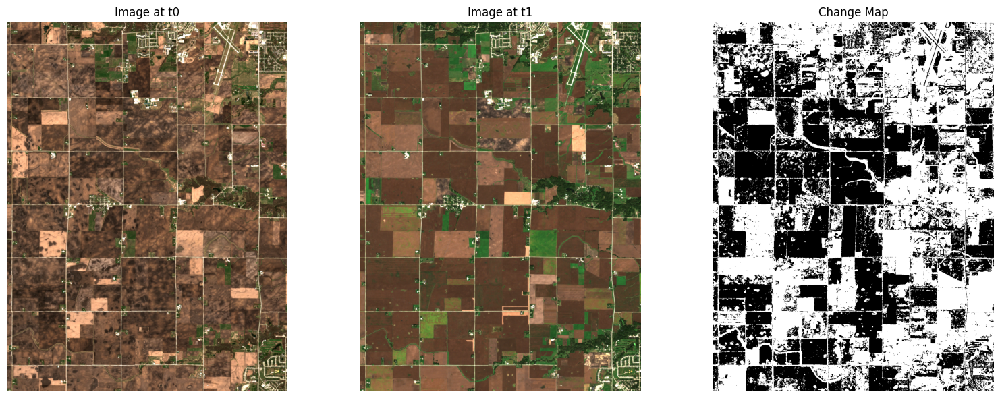

In [5]:
#crop_rotation_iowa_2019
old_date = "2019-04-20"
new_date = "2019-10-07"
loc_path = "crop_rotation_iowa_2019/"
create_oscd_entry(old_date, new_date, loc_path)

✅ Converted patch to OSCD-style dataset under: OSCD/crop_rotation/crop_rotation_iowa_2018/


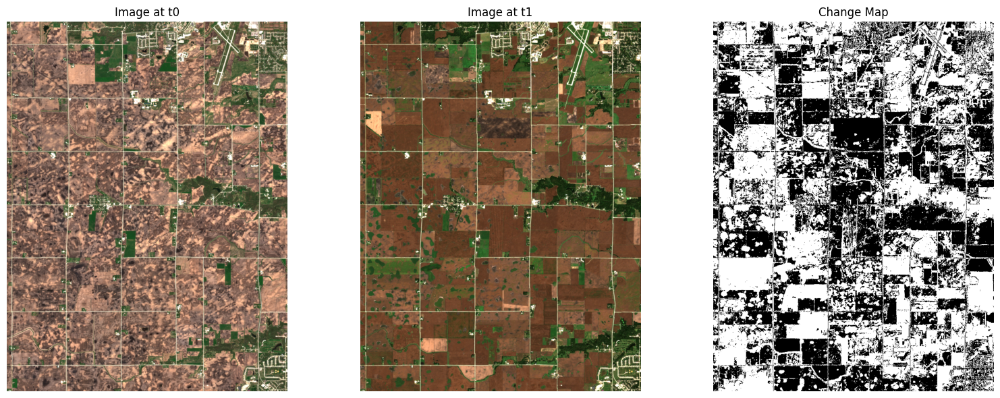

In [6]:
#crop_rotation_iowa_2018
old_date = "2018-05-07"
new_date = "2018-09-22"
loc_path = "crop_rotation_iowa_2018/"
create_oscd_entry(old_date, new_date, loc_path)